In [1]:
! pip uninstall -y pandas-profiling
! pip install pandas-profiling

Found existing installation: pandas-profiling 3.4.0
Uninstalling pandas-profiling-3.4.0:
  Successfully uninstalled pandas-profiling-3.4.0
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached pandas_profiling-3.4.0-py2.py3-none-any.whl (315 kB)


In [114]:
import pandas as pd
import numpy as np
import seaborn as sns

from sklearn.metrics import classification_report

In [3]:
df = pd.read_csv("Data_Taller_3.csv",sep=";")

## Limpieza y preparación de datos

In [4]:
df.head()

,JobSatisfaction,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,...,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,NewEmployee
0,4.0,41.0,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,...,80.0,0,8,0,1,6,4,0,5,0
1,2.0,49.0,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,...,80.0,1,10,3,3,10,7,1,7,0
2,3.0,37.0,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,...,80.0,0,7,3,3,0,0,0,0,0
3,3.0,33.0,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,...,80.0,0,8,3,3,8,7,3,0,0
4,2.0,NaN,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,...,80.0,1,6,3,3,2,2,2,2,0


In [5]:
df.isna().sum()

JobSatisfaction             12
Age                          3
Attrition                    1
BusinessTravel               0
DailyRate                    0
Department                   0
DistanceFromHome             0
Education                    0
EducationField               0
EmployeeCount                0
EmployeeNumber               0
EnvironmentSatisfaction      0
Gender                       0
HourlyRate                   0
JobInvolvement               0
JobLevel                     0
JobRole                      0
MaritalStatus                0
MonthlyIncome                0
MonthlyRate                  0
NumCompaniesWorked           0
Over18                       0
OverTime                     0
PercentSalaryHike            0
PerformanceRating            0
RelationshipSatisfaction     0
StandardHours                7
StockOptionLevel             0
TotalWorkingYears            0
TrainingTimesLastYear        0
WorkLifeBalance              0
YearsAtCompany               0
YearsInC

In [6]:
df[df.duplicated()]

,JobSatisfaction,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,...,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,NewEmployee


In [7]:
df.nunique()

JobSatisfaction                4
Age                           46
Attrition                      3
BusinessTravel                 3
DailyRate                    886
Department                     3
DistanceFromHome              29
Education                      6
EducationField                 7
EmployeeCount                  2
EmployeeNumber              1506
EnvironmentSatisfaction        4
Gender                         5
HourlyRate                    76
JobInvolvement                 4
JobLevel                       5
JobRole                       11
MaritalStatus                  6
MonthlyIncome               1349
MonthlyRate                 1427
NumCompaniesWorked            10
Over18                         1
OverTime                       3
PercentSalaryHike             15
PerformanceRating              2
RelationshipSatisfaction       4
StandardHours                  1
StockOptionLevel               4
TotalWorkingYears             40
TrainingTimesLastYear          7
WorkLifeBa

* Podemos ver que hay algunos valores faltantes en la variable de interes JobSatisfaction (13) en las demas variables hay datos faltantes pero son muy pocos.

* No hay valores duplicados

Antes de lidiar con los valores faltantes vamos a buscar outliers

In [8]:
df.describe()

,JobSatisfaction,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,...,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,NewEmployee
count,1494.000000,1503.000000,1506.000000,1506.000000,1506.000000,1506.000000,1506.000000,1506.000000,1506.000000,1506.000000,...,1499.0,1506.000000,1506.000000,1506.000000,1506.000000,1506.000000,1506.000000,1506.000000,1506.000000,1506.000000
mean,2.744311,37.086494,803.978752,9.229084,2.915671,1.000664,753.500000,2.729084,66.280212,2.729084,...,80.0,0.790173,11.220452,2.802789,2.758964,7.041169,4.212483,2.169987,4.112882,0.007968
std,1.099938,10.848391,403.962331,8.135153,1.031172,0.025768,434.889066,1.092854,21.275971,0.717816,...,0.0,0.850911,7.778530,1.293076,0.705698,6.568092,3.618337,3.196186,3.572208,0.088938
min,1.000000,3.000000,102.000000,1.000000,1.000000,1.000000,1.000000,1.000000,30.000000,1.000000,...,80.0,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2.000000,30.000000,465.000000,2.000000,2.000000,1.000000,377.250000,2.000000,48.000000,2.000000,...,80.0,0.000000,6.000000,2.000000,2.000000,3.000000,2.000000,0.000000,2.000000,0.000000
50%,3.000000,36.000000,805.000000,7.000000,3.000000,1.000000,753.500000,3.000000,66.000000,3.000000,...,80.0,1.000000,10.000000,3.000000,3.000000,5.000000,3.000000,1.000000,3.000000,0.000000
75%,4.000000,43.000000,1161.000000,14.000000,4.000000,1.000000,1129.750000,4.000000,84.000000,3.000000,...,80.0,1.000000,15.000000,3.000000,3.000000,9.000000,7.000000,3.000000,7.000000,0.000000
max,4.000000,200.000000,1499.000000,29.000000,7.000000,2.000000,1506.000000,4.000000,190.000000,4.000000,...,80.0,3.000000,40.000000,6.000000,4.000000,100.000000,18.000000,15.000000,17.000000,1.000000


Vemos que Los valores de JobSatisfaction van de 1 a 4 y no hay valores atipicos

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


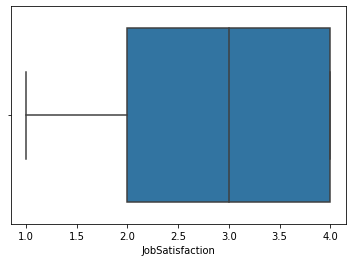

In [9]:
sns.boxplot(df["JobSatisfaction"])

Vemos que en la variable edad hay 3 valores atipicos. Hay edades mayores a 100 y una en 3 valores que no son posibles en el contexto de negocio. Van a ser reemplazados por la media

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


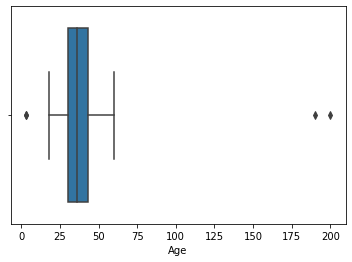

In [10]:
sns.boxplot(df["Age"])

In [11]:
df['Age'] = np.where((df['Age'] > 100) | (df['Age'] < 18) , df["Age"][(df.Age > 18) | (df.Age < 100)].mean(), df['Age'])

No hay valores atipicos

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


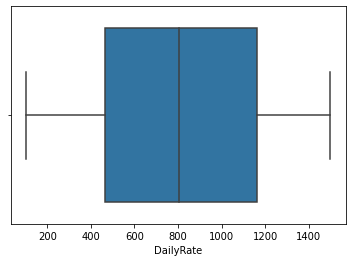

In [12]:
sns.boxplot(df["DailyRate"])

No hay valores atipicos

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


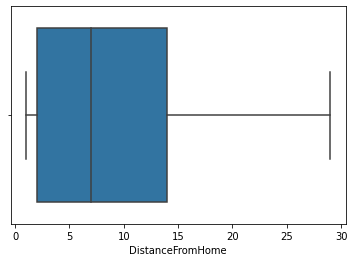

In [13]:
sns.boxplot(df["DistanceFromHome"])

No hay valores atipicos

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


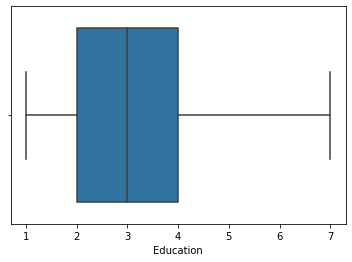

In [14]:
sns.boxplot(df["Education"])

Se puede ver que hay muchos valores únicos pero no se limpiaran por lo que es una columna que no se va a necesitar 

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


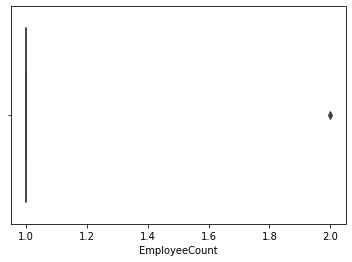

In [15]:
sns.boxplot(df["EmployeeCount"])

No hay valores atipicos

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


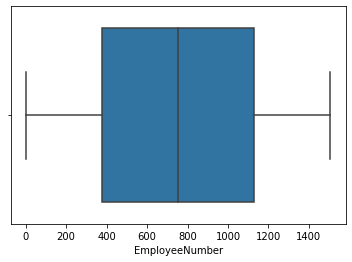

In [16]:
sns.boxplot(df["EmployeeNumber"])

No hay valores atipicos

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


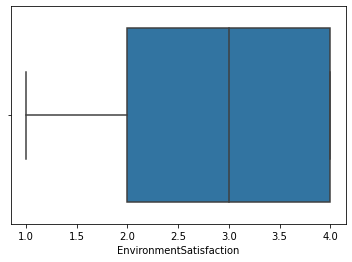

In [17]:
sns.boxplot(df["EnvironmentSatisfaction"])

Hay valores atipicos pero pueden ser reales. Se debería validar con el negocio la factibilidad de estos valores. Por el momento los dejaremos así en el dataset

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


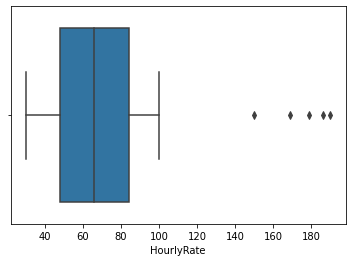

In [18]:
sns.boxplot(df["HourlyRate"])

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


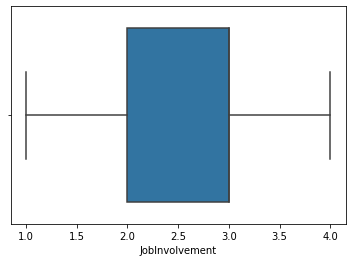

In [19]:
sns.boxplot(df["JobInvolvement"])

Es una columna con valores únicos

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


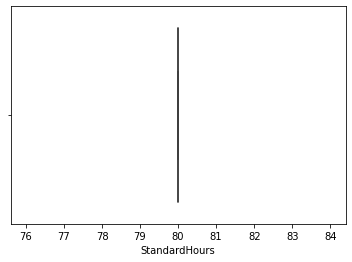

In [20]:
sns.boxplot(df["StandardHours"])

Vemos que hay un valor en 3 pero se considera que es un valor factible dentro del negocio por lo que no se realiza ninguna limpieza.

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


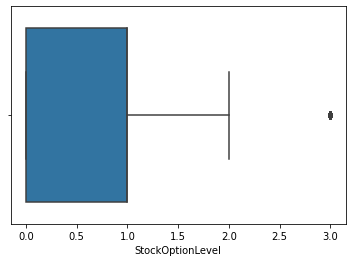

In [21]:
sns.boxplot(df["StockOptionLevel"])

Vemos valores altos pero se considera que también son factibles dentro del contexto de negocio por lo que no se eliminan. 

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


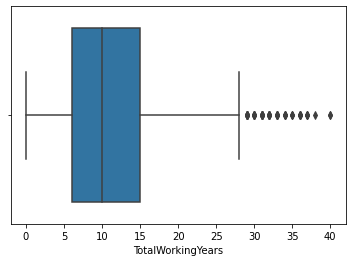

In [22]:
sns.boxplot(df["TotalWorkingYears"])

Vemos valores altos pero se considera que también son factibles dentro del contexto de negocio por lo que no se eliminan. 

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


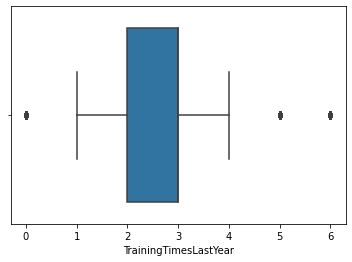

In [23]:
sns.boxplot(df["TrainingTimesLastYear"])

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


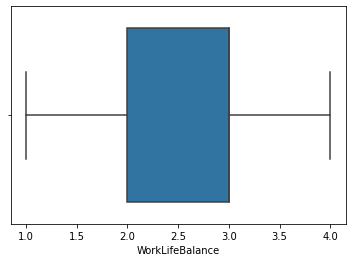

In [24]:
sns.boxplot(df["WorkLifeBalance"])

Vemos que si hay valores atipicos que deben ser limpiados. Se deberia consultar al negocio desde cuantos años es considerado valor atipico. Sin embargo, al no poder consultar al negocio se considerara que mayor a 40 años es atipico, es decir solo el valor que aparece 100 años.

Para corregirlo, se asumirá que se añadió un 0 más a 100 años por lo que en realidad deberia ser 10 años.

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


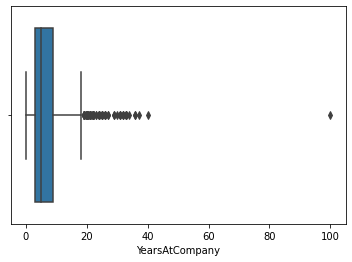

In [25]:
sns.boxplot(df["YearsAtCompany"])

In [26]:
df['YearsAtCompany'] = np.where(df['YearsAtCompany'] > 45,10, df['YearsAtCompany'])

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


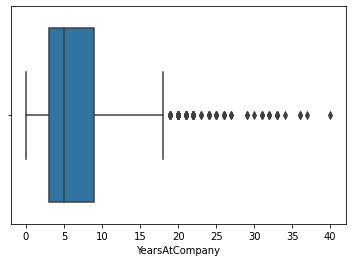

In [27]:
sns.boxplot(df["YearsAtCompany"])

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


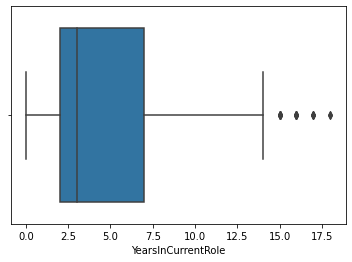

In [28]:
sns.boxplot(df["YearsInCurrentRole"])

Vemos valores altos pero se considera que también son factibles dentro del contexto de negocio por lo que no se eliminan. 

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


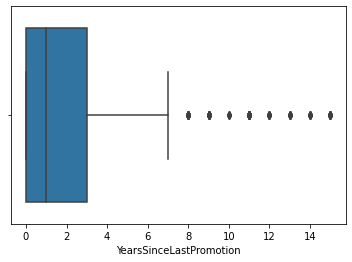

In [29]:
sns.boxplot(df["YearsSinceLastPromotion"])

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


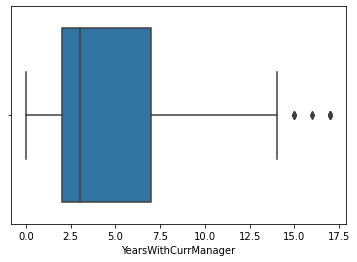

In [30]:
sns.boxplot(df["YearsWithCurrManager"])

Vemos que es una columna con muchos valores unicos.

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


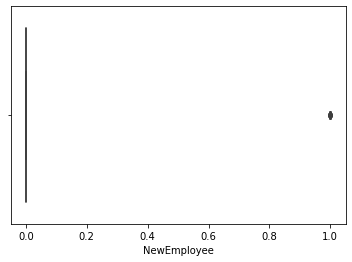

In [31]:
sns.boxplot(df["NewEmployee"])

In [32]:
df.describe().columns

Index(['JobSatisfaction', 'Age', 'DailyRate', 'DistanceFromHome', 'Education',
       'EmployeeCount', 'EmployeeNumber', 'EnvironmentSatisfaction',
       'HourlyRate', 'JobInvolvement', 'JobLevel', 'MonthlyIncome',
       'MonthlyRate', 'NumCompaniesWorked', 'PercentSalaryHike',
       'PerformanceRating', 'RelationshipSatisfaction', 'StandardHours',
       'StockOptionLevel', 'TotalWorkingYears', 'TrainingTimesLastYear',
       'WorkLifeBalance', 'YearsAtCompany', 'YearsInCurrentRole',
       'YearsSinceLastPromotion', 'YearsWithCurrManager', 'NewEmployee'],
      dtype='object')

Vemos que en la variable monthly income hay un valor muy elevado. Se podria dividir por 100 para que entre dentro del rango normal; sin embargo, no se quiere hacer ese supuesto por lo que se reemplazara por la media

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


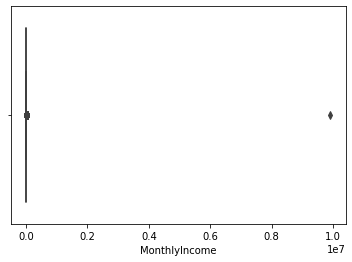

In [33]:
sns.boxplot(df["MonthlyIncome"])

In [34]:
df['MonthlyIncome'] = np.where(df['MonthlyIncome'] > 9900000,df['MonthlyIncome'][df['MonthlyIncome'] <9900000].mean(), df['MonthlyIncome'])

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


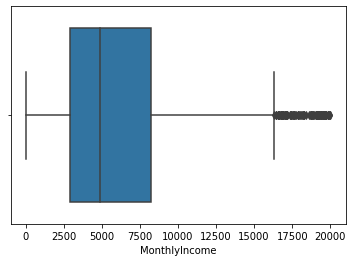

In [35]:
sns.boxplot(df["MonthlyIncome"])

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


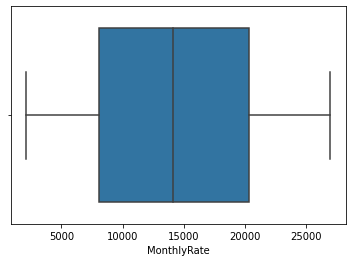

In [36]:
sns.boxplot(df["MonthlyRate"])

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


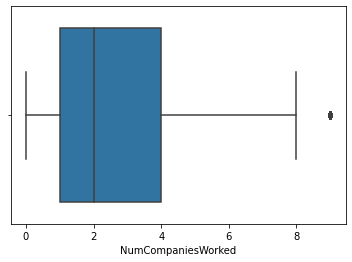

In [37]:
sns.boxplot(df["NumCompaniesWorked"])

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


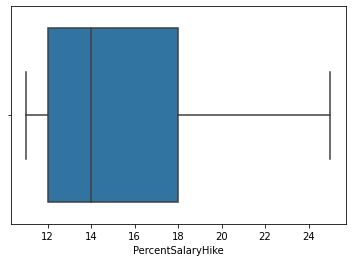

In [38]:
sns.boxplot(df["PercentSalaryHike"])

Vemos que es casi una columna de valores únicos (3), sin embargo puede ser de utilidad para la predicción.

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


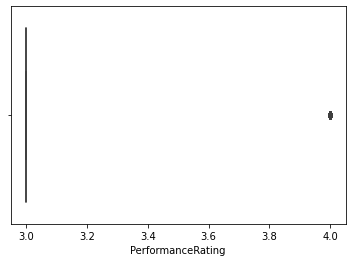

In [39]:
sns.boxplot(df["PerformanceRating"])

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


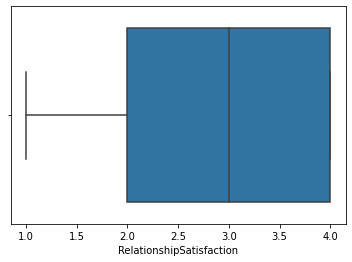

In [40]:
sns.boxplot(df["RelationshipSatisfaction"])

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


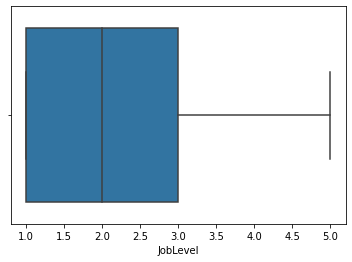

In [41]:
sns.boxplot(df["JobLevel"])

In [42]:
df.describe(include = [object])

,Attrition,BusinessTravel,Department,EducationField,Gender,JobRole,MaritalStatus,Over18,OverTime
count,1505,1506,1506,1506,1506,1506,1506,1506,1506
unique,3,3,3,7,5,11,6,1,3
top,No,Travel_Rarely,Research & Development,Life Sciences,Male,Sales Executive,Married,Y,No
freq,1254,1069,989,619,729,330,671,1506,941


Vemos que la colunma de Attrition tiene escrita la palabra "Na" en vez de ser un valor faltante. Reemplazarenos estos valores por la moda que es No.

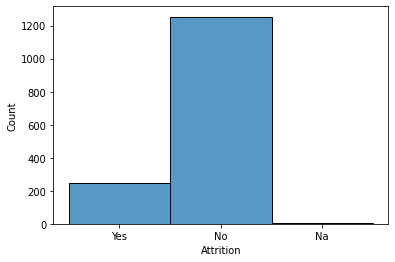

In [43]:
sns.histplot(data=df, x="Attrition")

In [44]:
df.Attrition = df.Attrition.mask(df.Attrition == "Na",df.Attrition.mode())

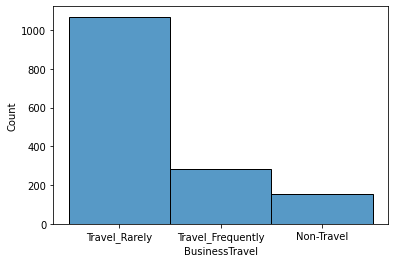

In [45]:
sns.histplot(data=df, x="BusinessTravel")

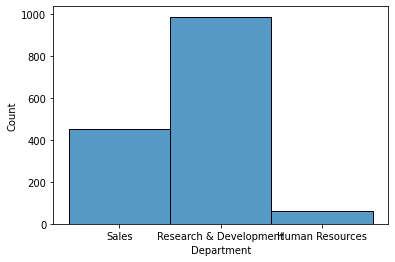

In [46]:
sns.histplot(data=df, x="Department")

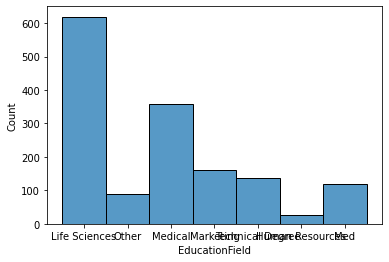

In [47]:
sns.histplot(data=df, x="EducationField")

Se asume que el valor de Med deberia ser Medical por lo que reemplazamos estos valores

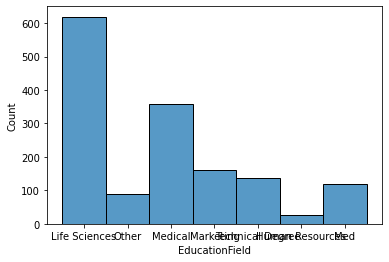

In [48]:
sns.histplot(data=df, x="EducationField")

In [49]:
df.EducationField = df.EducationField.mask(df.EducationField == "Med","Medical")

Vemos que hay varios valores que significan lo mismo por lo que unificamos los valores para que sean male,female

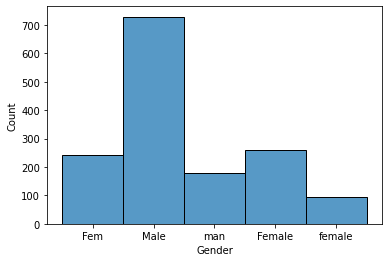

In [50]:
sns.histplot(data=df, x="Gender")

In [51]:
df.Gender = df.Gender.replace({"Fem":"female",
                   "Male":"male",
                   "man":"male",
                   "Female":"female"})

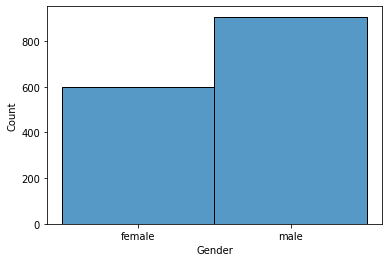

In [52]:
sns.histplot(data=df, x="Gender")

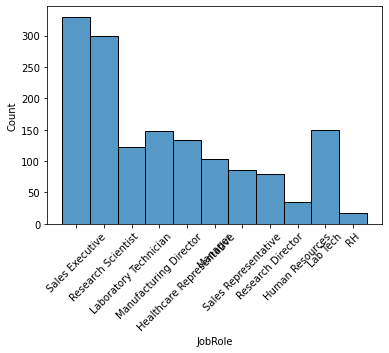

In [53]:
import matplotlib.pylab as plt 

plt.xticks(rotation=45)
sns.histplot(data=df, x="JobRole")

Vemos que también hay varios valores que significan lo mismo. Se asume que S es single, D es divorced y M es married

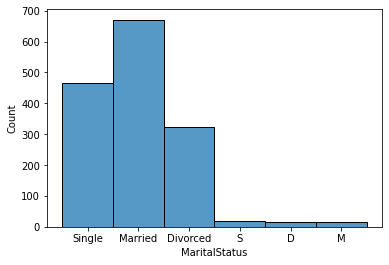

In [54]:
sns.histplot(data=df, x="MaritalStatus")

In [55]:
df.MaritalStatus = df.MaritalStatus.replace({"S":"Single",
                   "D":"Married",
                   "M":"Divorced",})

Vemos que es una columna con valor único

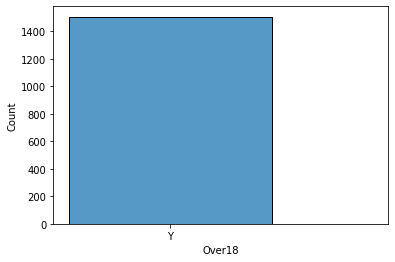

In [56]:
sns.histplot(data=df, x="Over18")

Realizamos el mismo procedimiento que hicimos arriba.

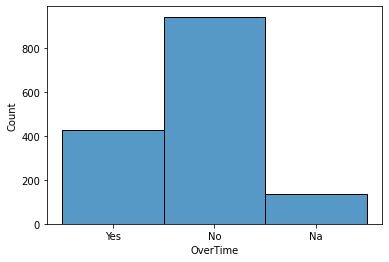

In [57]:
sns.histplot(data=df, x="OverTime")

In [58]:
df.OverTime = df.OverTime.mask(df.OverTime == "Na",df.OverTime.mode())

## Análisis exploratorio de datos y selección de features

In [59]:
from pandas_profiling import ProfileReport

profile = ProfileReport(df)

profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Si bien en la sección 1 ya habiamos realizado un análisis univariado, aquí confirmamos que la columna Over18 y StandardHours tienen valores únicos y no nos serán de utilidad. También se identifica que la variable EmployeeNumber es un ID único de cada empleado. La variable EmployeeCount tampoco nos será de utilidad porque tiene 1505 valores en 1 y 1 en 2.

In [60]:
df.drop(["Over18","StandardHours","EmployeeNumber","EmployeeCount"],axis = 1, inplace = True)

In [61]:
df.Age.fillna(df.Age.mean(),inplace = True)
df.OverTime.fillna(df.OverTime.mode()[0],inplace = True)
df.Attrition.fillna(df.Attrition.mode()[0], inplace = True)

In [62]:
df.OverTime

0       Yes
1        No
2       Yes
3       Yes
4        No
       ... 
1501     No
1502     No
1503     No
1504    Yes
1505    Yes
Name: OverTime, Length: 1506, dtype: object

### Análisis bivariado

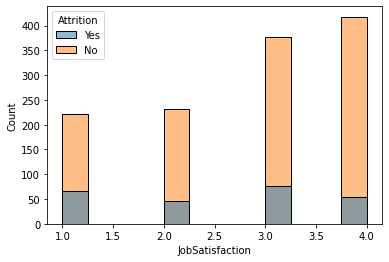

In [63]:
sns.histplot(data=df, x="JobSatisfaction",hue="Attrition")

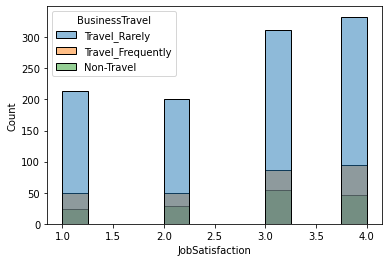

In [64]:
sns.histplot(data=df,x="JobSatisfaction", hue="BusinessTravel");

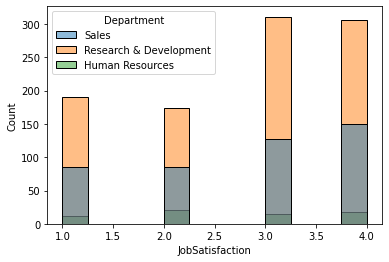

In [65]:
sns.histplot(data=df, x="JobSatisfaction", hue="Department")

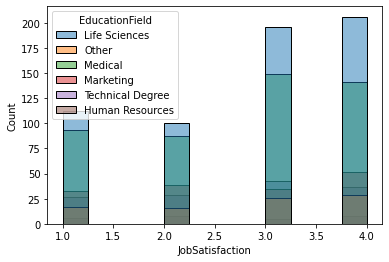

In [66]:
sns.histplot(data=df, x="JobSatisfaction",hue="EducationField")

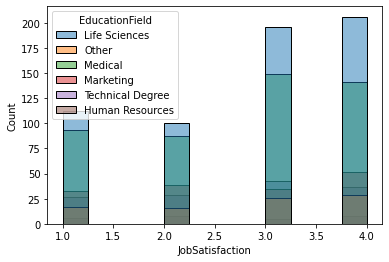

In [67]:
sns.histplot(data=df, x="JobSatisfaction",hue="EducationField")

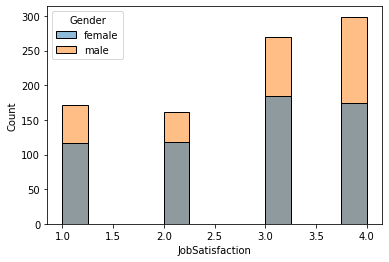

In [68]:
sns.histplot(data=df, x="JobSatisfaction",hue="Gender")

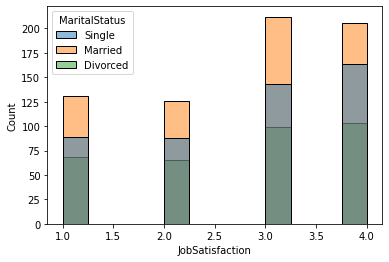

In [69]:
sns.histplot(data=df, x="JobSatisfaction",hue="MaritalStatus")

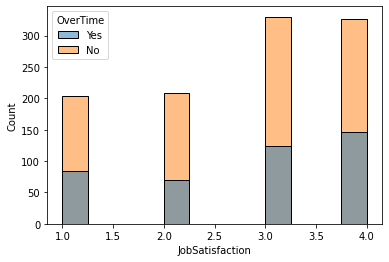

In [70]:
sns.histplot(data=df, x="JobSatisfaction",hue="OverTime")

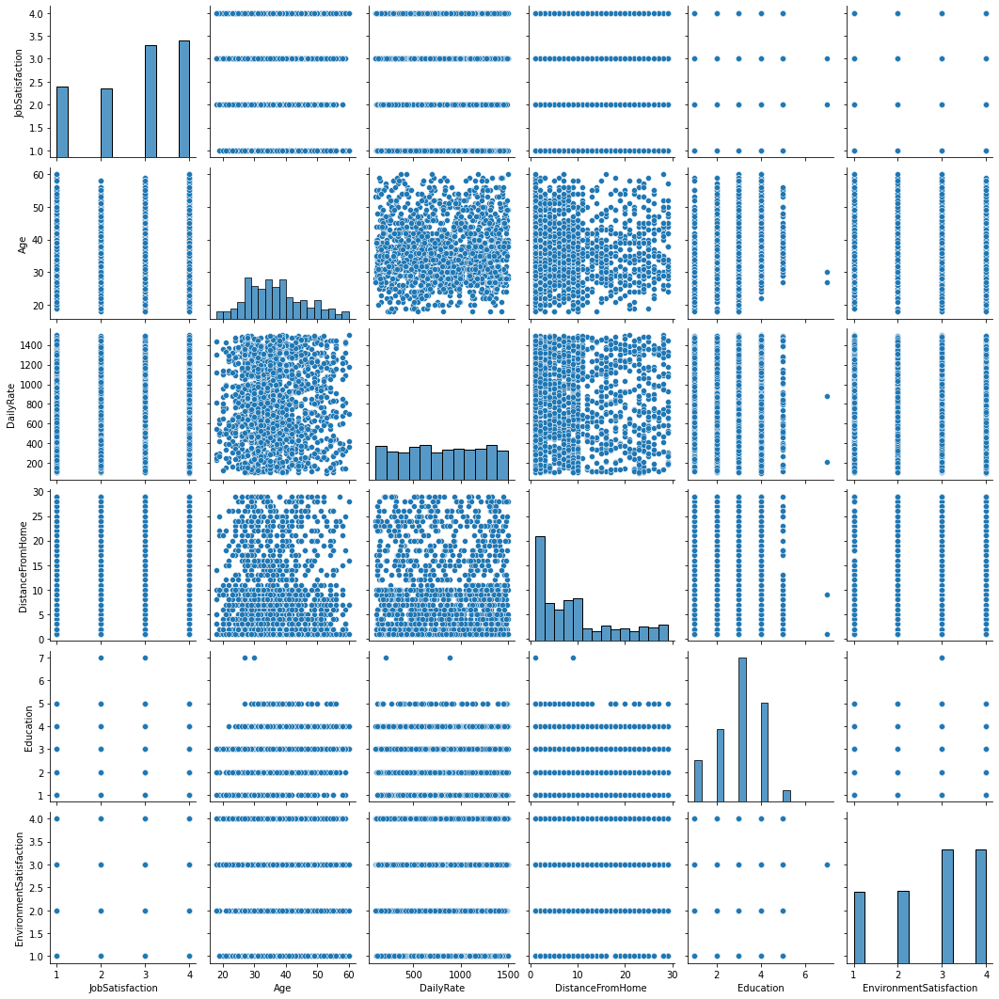

In [71]:
sns.pairplot(df.iloc[:,:10])

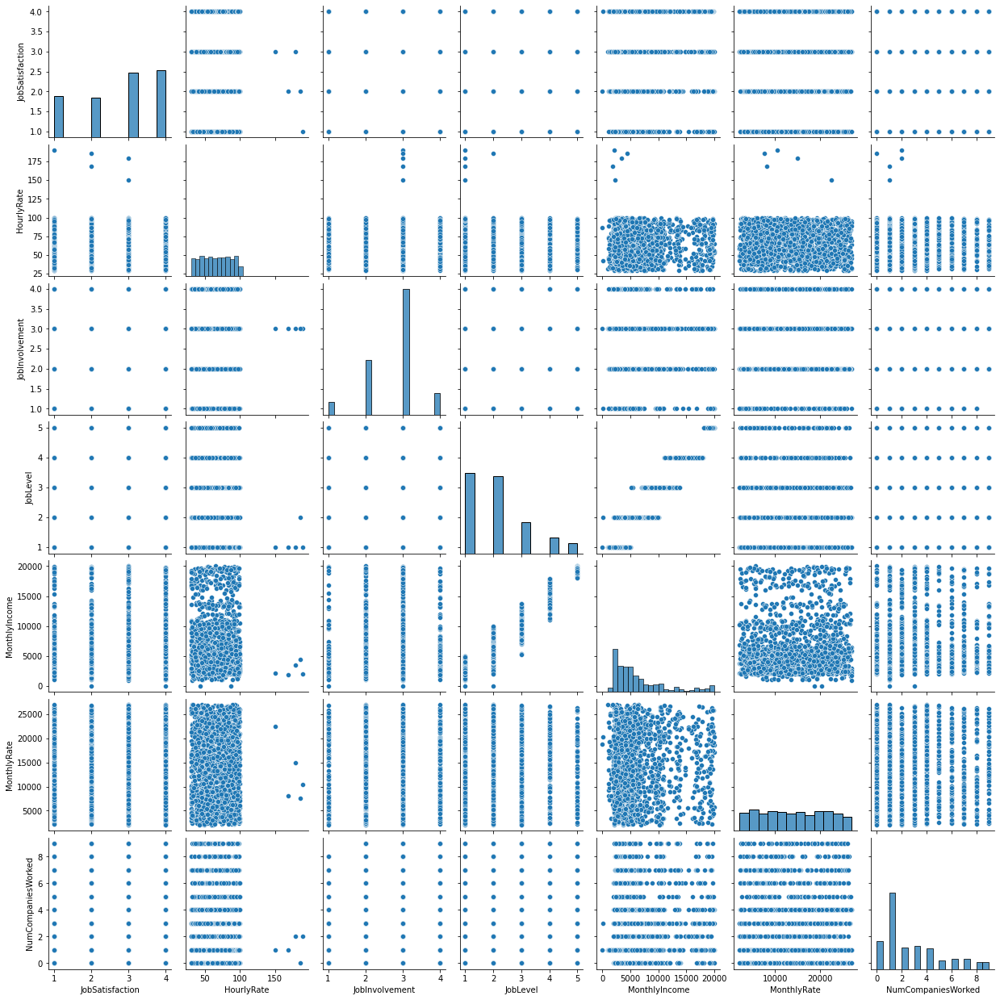

In [72]:
sns.pairplot(df.iloc[:,[0]+list(range(10,20))])

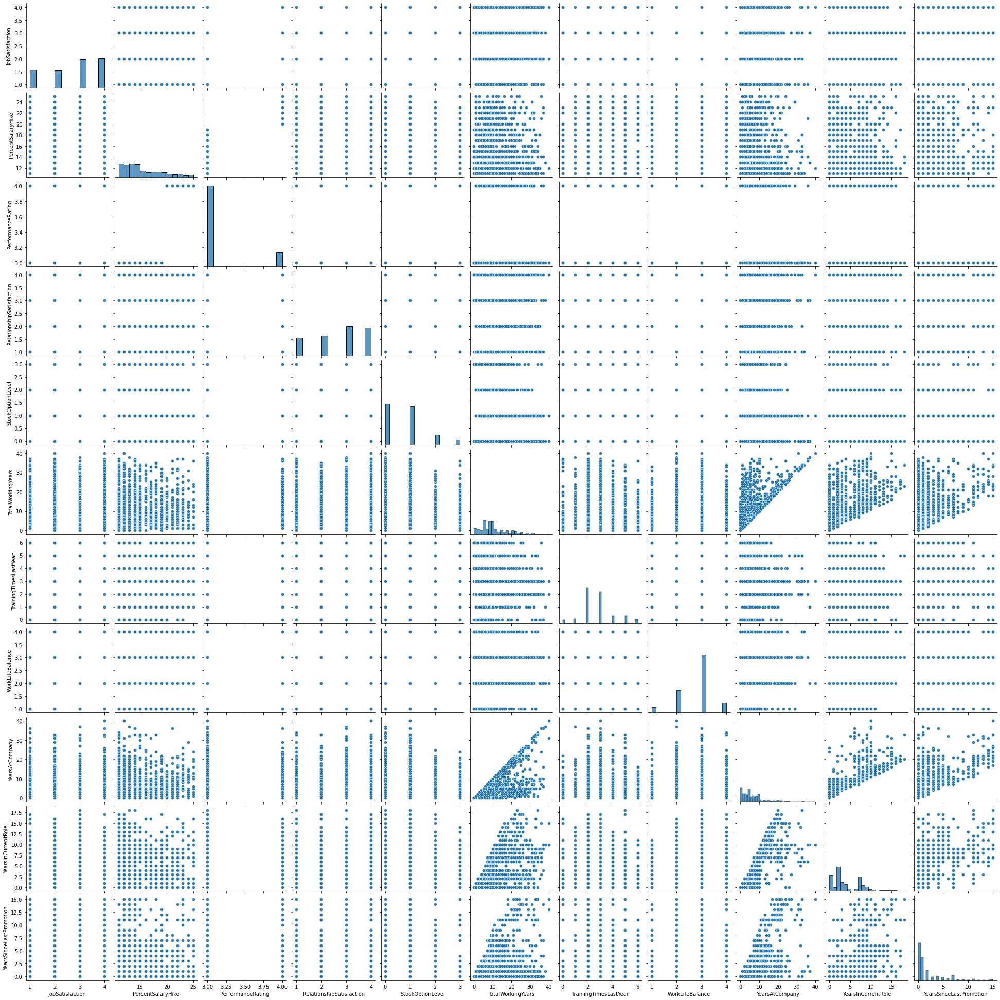

In [73]:
sns.pairplot(df.iloc[:,[0]+list(range(20,30))])

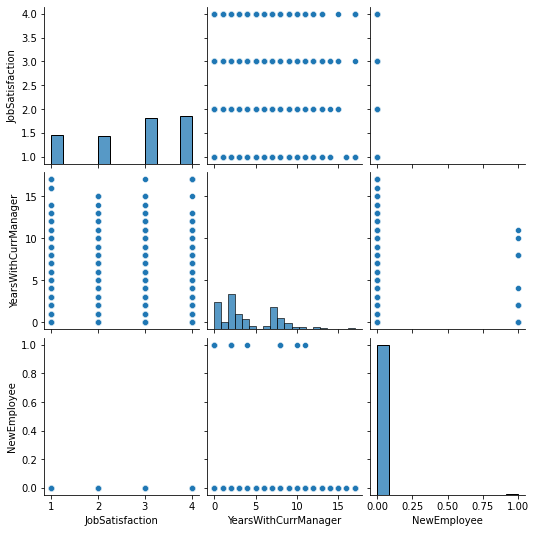

In [74]:
sns.pairplot(df.iloc[:,[0]+list(range(30,32))])

In [75]:
df.corr()

,JobSatisfaction,Age,DailyRate,DistanceFromHome,Education,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,MonthlyIncome,...,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,NewEmployee
JobSatisfaction,1.000000,-0.005918,0.033041,-0.000678,-0.010619,-0.009773,-0.071723,-0.014026,-0.004167,-0.010615,...,-0.006297,0.001223,-0.021613,0.001689,-0.022694,-0.003352,-0.003484,-0.017950,-0.024450,NaN
Age,-0.005918,1.000000,0.012239,-0.011933,0.197532,0.008649,0.017617,0.027189,0.510006,0.500153,...,0.058495,0.037001,0.677219,-0.017704,-0.018687,0.312690,0.215451,0.216190,0.201925,0.011451
DailyRate,0.033041,0.012239,1.000000,-0.003234,-0.020554,0.020272,0.035993,0.039691,0.000630,0.007364,...,0.007040,0.043561,0.012592,-0.003081,-0.041068,-0.035999,0.011055,-0.032282,-0.031137,0.004610
DistanceFromHome,-0.000678,-0.011933,-0.003234,1.000000,0.010938,-0.014165,0.016620,0.005401,0.001254,-0.019109,...,0.001979,0.047167,-0.002332,-0.037896,-0.030884,0.004894,0.016900,0.008902,0.015389,0.037883
Education,-0.010619,0.197532,-0.020554,0.010938,1.000000,-0.022055,0.011466,0.033747,0.107740,0.100889,...,-0.005672,0.013140,0.151098,-0.024939,0.018616,0.073190,0.063929,0.053745,0.072214,0.021822
EnvironmentSatisfaction,-0.009773,0.008649,0.020272,-0.014165,-0.022055,1.000000,-0.062745,-0.003840,0.003015,-0.006394,...,0.006015,0.005281,-0.001568,-0.014793,0.031582,0.000837,0.022633,0.015095,-0.004926,-0.025629
HourlyRate,-0.071723,0.017617,0.035993,0.016620,0.011466,-0.062745,1.000000,0.046175,-0.045705,-0.033904,...,0.002523,0.052467,-0.018818,0.004111,-0.013200,-0.030350,-0.031837,-0.029174,-0.034748,0.021293
JobInvolvement,-0.014026,0.027189,0.039691,0.005401,0.033747,-0.003840,0.046175,1.000000,-0.012979,-0.014676,...,0.039985,0.024357,-0.010003,-0.013216,-0.022748,-0.027031,0.008620,-0.025673,0.021522,0.002612
JobLevel,-0.004167,0.510006,0.000630,0.001254,0.107740,0.003015,-0.045705,-0.012979,1.000000,0.950193,...,0.025480,0.013703,0.783905,-0.017941,0.038299,0.538469,0.397059,0.354341,0.379368,0.042800
MonthlyIncome,-0.010615,0.500153,0.007364,-0.019109,0.100889,-0.006394,-0.033904,-0.014676,0.950193,1.000000,...,0.028697,0.007342,0.774533,-0.023639,0.030365,0.519219,0.372653,0.346441,0.349785,0.049837


Con el análisis realizado no es muy claro que exista una relación entre la variable objetivo y cualquier otra variable por si sola. Es posible que exista relación con las interacciones o relaciones no lineales

## Construcción y selección del mejor modelo

División del dataset.

Se usará cross validation para la busqueda de hiperparametros por lo que se hara una división de train y test

In [76]:
from sklearn.model_selection import train_test_split

In [77]:
df = df[df.NewEmployee != 1]

In [78]:
X = df.drop("JobSatisfaction",axis=1)
y = df.JobSatisfaction

In [79]:
X.Gender = X.Gender.apply(lambda x: 1 if x == "male" else 0)

In [80]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=1)

In [81]:
from sklearn.preprocessing import OneHotEncoder

enc = OneHotEncoder(handle_unknown='ignore')
enc.fit(X_train[["Attrition","BusinessTravel","Department","EducationField","JobRole","MaritalStatus","OverTime"]])


OneHotEncoder(handle_unknown='ignore')

In [82]:
X_train_new = pd.DataFrame(enc.transform(X_train[["Attrition","BusinessTravel","Department","EducationField","JobRole","MaritalStatus","OverTime"]]).toarray(),columns=  [item for sublist in enc.categories_ for item in sublist])

In [83]:
X_train_new

,No,Yes,Non-Travel,Travel_Frequently,Travel_Rarely,Human Resources,Research & Development,Sales,Human Resources,Life Sciences,...,RH,Research Director,Research Scientist,Sales Executive,Sales Representative,Divorced,Married,Single,No,Yes
0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
1,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0
2,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0
3,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
4,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
996,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
997,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,...,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0
998,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,...,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0


In [84]:
X_train_new = pd.concat([X_train.reset_index(drop=True),X_train_new.reset_index(drop=True)],axis = 1)

In [85]:
X_train_new.drop(["Attrition","BusinessTravel","Department","EducationField","JobRole","MaritalStatus","OverTime"],axis = 1,inplace = True)

### Regresión logistica

In [86]:
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import RandomizedSearchCV

model = LogisticRegression(multi_class='ovr')
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
# define search space
space = dict()
space['solver'] = ['liblinear']
space['penalty'] = ['l1', 'l2']
search = RandomizedSearchCV(model, space, n_iter=500, scoring='f1', n_jobs=-1, cv=cv, random_state=1)

In [87]:
result = search.fit(X_train_new, y_train)

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_search.py:296: UserWarning: The total space of parameters 2 is smaller than n_iter=500. Running 2 iterations. For exhaustive searches, use GridSearchCV.
  UserWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_search.py:972: UserWarning: One or more of the test scores are non-finite: [nan nan]
  category=UserWarning,


In [88]:
result.best_params_

{'solver': 'liblinear', 'penalty': 'l1'}

In [89]:
from sklearn.metrics import f1_score
pred = result.predict(X_train_new)
f1_score(pred,y_train, average = "weighted")

0.4431460529643899

Modelo Base

In [90]:
lm = LogisticRegression(multi_class='ovr')
lm.fit(X_train_new, y_train)
pred = lm.predict(X_train_new)
f1_score(pred,y_train, average = "weighted")

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


0.4055269323035654

## Arbol de decisión

In [91]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn import tree
from sklearn.pipeline import Pipeline

pca =PCA()
std_slc = StandardScaler()

In [92]:
dec_tree = tree.DecisionTreeClassifier()

In [93]:
pipe = Pipeline(steps=[('std_slc', std_slc),
                           ('pca', pca),
                           ('dec_tree', dec_tree)])

In [94]:
n_components = list(range(1,X_train_new.shape[1]+1,1))

In [95]:
criterion = ['gini', 'entropy']
max_depth = [2,4,6,8,10,12]
parameters = dict(pca__n_components=n_components,
dec_tree__criterion=criterion,
dec_tree__max_depth=max_depth)

In [96]:
clf_GS = RandomizedSearchCV(pipe, parameters)
clf_GS.fit(X_train_new, y_train)

RandomizedSearchCV(estimator=Pipeline(steps=[('std_slc', StandardScaler()),
                                             ('pca', PCA()),
                                             ('dec_tree',
                                              DecisionTreeClassifier())]),
                   param_distributions={'dec_tree__criterion': ['gini',
                                                                'entropy'],
                                        'dec_tree__max_depth': [2, 4, 6, 8, 10,
                                                                12],
                                        'pca__n_components': [1, 2, 3, 4, 5, 6,
                                                              7, 8, 9, 10, 11,
                                                              12, 13, 14, 15,
                                                              16, 17, 18, 19,
                                                              20, 21, 22, 23,
                                        

In [97]:
clf_GS.best_params_

{'pca__n_components': 6,
 'dec_tree__max_depth': 2,
 'dec_tree__criterion': 'entropy'}

In [98]:
pred = clf_GS.predict(X_train_new)
f1_score(pred,y_train, average = "weighted")

0.47011163256170424

## Random Forest

In [140]:
from sklearn.ensemble import RandomForestClassifier

clf = RandomForestClassifier(random_state=0)
pipe = Pipeline(steps=[('std_slc', std_slc),
                           ('pca', pca),
                           ('rf', clf)])

In [141]:
# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 200, stop = 1000, num = 10)]
# Number of features to consider at every split
max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 30, num = 11)]
max_depth.append(None)
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2]

In [144]:
parameters = dict(pca__n_components=n_components,
rf__n_estimators=[20],
rf__max_depth=[5],
rf__max_features=max_features,
rf__min_samples_leaf=min_samples_leaf,
)


In [145]:
rf_RS = RandomizedSearchCV(pipe, parameters)
rf_RS.fit(X_train_new, y_train)

RandomizedSearchCV(estimator=Pipeline(steps=[('std_slc', StandardScaler()),
                                             ('pca', PCA()),
                                             ('rf',
                                              RandomForestClassifier(random_state=0))]),
                   param_distributions={'pca__n_components': [1, 2, 3, 4, 5, 6,
                                                              7, 8, 9, 10, 11,
                                                              12, 13, 14, 15,
                                                              16, 17, 18, 19,
                                                              20, 21, 22, 23,
                                                              24, 25, 26, 27,
                                                              28, 29, 30, ...],
                                        'rf__max_depth': [5],
                                        'rf__max_features': ['auto', 'sqrt'],
                               

In [132]:
pred = rf_RS.predict(X_train_new)
f1_score(pred,y_train, average = "weighted")

0.9990004762041602

### Gradient Boosting

In [104]:
from sklearn.ensemble import GradientBoostingClassifier

clf = GradientBoostingClassifier(random_state=0)

In [105]:
pipe = Pipeline(steps=[('std_slc', std_slc),
                           ('pca', pca),
                           ('gb', clf)])


In [106]:
parameters = dict(pca__n_components=n_components,
gb__n_estimators=n_estimators,
gb__max_depth=max_depth,
gb__max_features=max_features,
gb__min_samples_split=min_samples_split,
gb__min_samples_leaf=min_samples_leaf)


In [107]:
gb_RS = RandomizedSearchCV(pipe, parameters)
gb_RS.fit(X_train_new, y_train)

RandomizedSearchCV(estimator=Pipeline(steps=[('std_slc', StandardScaler()),
                                             ('pca', PCA()),
                                             ('gb',
                                              GradientBoostingClassifier(random_state=0))]),
                   param_distributions={'gb__max_depth': [10, 20, 30, 40, 50,
                                                          60, 70, 80, 90, 100,
                                                          110, None],
                                        'gb__max_features': ['auto', 'sqrt'],
                                        'gb__min_samples_leaf': [1, 2, 4],
                                        'gb__min_samples_split': [2, 5, 10],
                                        'gb__n_estimators': [200, 400, 600, 800,
                                                             1000, 1200, 1400,
                                                             1600, 1800, 2000],
                     

In [108]:
pred = gb_RS.predict(X_train_new)
f1_score(pred,y_train, average = "weighted")

1.0

### Test

In [165]:
X_test_new = pd.DataFrame(enc.transform(X_test[["Attrition","BusinessTravel","Department","EducationField","JobRole","MaritalStatus","OverTime"]]).toarray(),columns=  [item for sublist in enc.categories_ for item in sublist])
X_test_new = pd.concat([X_test.reset_index(drop=True),X_test_new.reset_index(drop=True)],axis = 1)
X_test_new.drop(["Attrition","BusinessTravel","Department","EducationField","JobRole","MaritalStatus","OverTime"],axis = 1,inplace = True)

X_test_new.columns

Index(['Age', 'DailyRate', 'DistanceFromHome', 'Education',
       'EnvironmentSatisfaction', 'Gender', 'HourlyRate', 'JobInvolvement',
       'JobLevel', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'PercentSalaryHike', 'PerformanceRating', 'RelationshipSatisfaction',
       'StockOptionLevel', 'TotalWorkingYears', 'TrainingTimesLastYear',
       'WorkLifeBalance', 'YearsAtCompany', 'YearsInCurrentRole',
       'YearsSinceLastPromotion', 'YearsWithCurrManager', 'NewEmployee', 'No',
       'Yes', 'Travel_Frequently', 'Travel_Rarely', 'Research & Development',
       'Sales', 'Life Sciences', 'Marketing', 'Med', 'Medical', 'Manager',
       'Manufacturing Director', 'Research Director', 'Research Scientist',
       'Sales Executive', 'Divorced', 'Married', 'No', 'Yes'],
      dtype='object')

In [116]:
# Resultados del Gradient Boosting en test
preds = gb_RS.predict(X_test_new)
print(classification_report(preds, y_test))

              precision    recall  f1-score   support

         1.0       0.12      0.31      0.17        42
         2.0       0.16      0.19      0.17        70
         3.0       0.44      0.32      0.37       193
         4.0       0.44      0.38      0.41       189

    accuracy                           0.32       494
   macro avg       0.29      0.30      0.28       494
weighted avg       0.37      0.32      0.34       494



In [117]:
# Resultados del Random Forest en test
preds = rf_RS.predict(X_test_new)
print(classification_report(preds, y_test))

              precision    recall  f1-score   support

         1.0       0.06      0.21      0.09        28
         2.0       0.05      0.15      0.07        26
         3.0       0.50      0.30      0.37       236
         4.0       0.46      0.37      0.41       204

    accuracy                           0.31       494
   macro avg       0.27      0.26      0.24       494
weighted avg       0.44      0.31      0.36       494



In [118]:
# Resultados del Decision Tree en test
preds = clf_GS.predict(X_test_new)
print(classification_report(preds, y_test))

              precision    recall  f1-score   support

         1.0       0.00      0.00      0.00         0
         2.0       0.00      0.00      0.00         0
         3.0       0.01      0.12      0.01         8
         4.0       0.98      0.33      0.49       486

    accuracy                           0.32       494
   macro avg       0.25      0.11      0.13       494
weighted avg       0.97      0.32      0.48       494



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [119]:
# Resultados del Logistic Regression en test
preds = result.predict(X_test_new)
print(classification_report(preds, y_test))

              precision    recall  f1-score   support

         1.0       0.09      0.28      0.14        36
         2.0       0.06      0.20      0.09        25
         3.0       0.42      0.27      0.33       217
         4.0       0.46      0.35      0.40       216

    accuracy                           0.30       494
   macro avg       0.26      0.27      0.24       494
weighted avg       0.40      0.30      0.33       494



Finalmente escogimos el Gradient Boosting como el mejor modelo ya que a pesar de tener grandes sintomas de overfitting es el que mejor balanceado esta al momento de clasificar cada una de las categorias

## Interpretación del Modelo

Debido a que en el modelo utilizamos PCA, esto hace que sea mucho menos interpretable. Para poder interpretar el modelo, entrenamos uno nuevo con las variables sin PCA para identificar la importancia

In [120]:
from sklearn.ensemble import GradientBoostingClassifier

clf = GradientBoostingClassifier(n_estimators=100, learning_rate=1.0,max_depth=1, random_state=0)
clf.fit(X_train_new,y_train)

GradientBoostingClassifier(learning_rate=1.0, max_depth=1, random_state=0)

In [121]:
import matplotlib.pyplot as plt

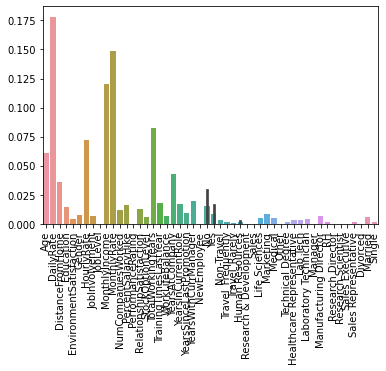

In [122]:
plt.xticks(rotation=90)
sns.barplot(x=X_train_new.columns, y=clf.feature_importances_)


### ¿Son Age y MonthlyIncome features satisfacción del empleado?

Vemos que la variable Age si es significativa para la predicción de satisfacción del empleado.
MonthlyIncome es incluso más importante para el modelo.

Las variables mas importantes son:
* DailyRate
* MonthlyRate
* TotalWorkingYears

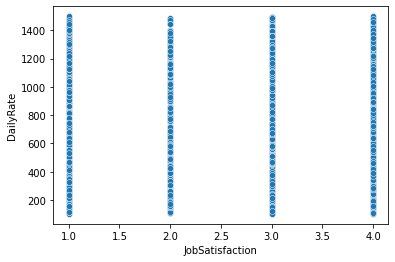

In [123]:
sns.scatterplot(data=df, x="JobSatisfaction", y="DailyRate")


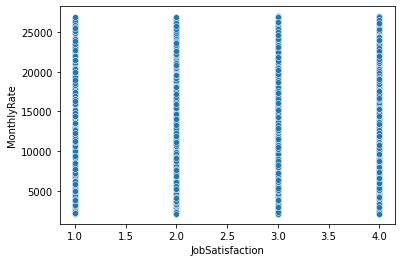

In [124]:
sns.scatterplot(data=df, x="JobSatisfaction", y="MonthlyRate")


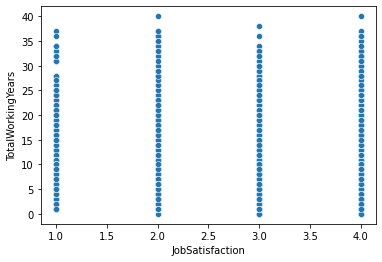

In [125]:
sns.scatterplot(data=df, x="JobSatisfaction", y="TotalWorkingYears")


Es dificil interpretar los efectos de estas variables sobre la variable objetivo.

Se podrian hacer varias hipotesis: 

Entre más alto el DailyRate que es el wage diario, mas satisfacción. Lo mismo con el MonthlyRate.

En cuanto a los años totales trabajados, se podria tener la hipotesis de que a menos años trabajados mas satisfacción ya que todavía están lejos de retirarse y seguramente más motivados.

## Estimación del nivel de satisfacción de nuevos empleados 

In [159]:
df = pd.read_csv("Data_Taller_3.csv",sep=";")
df = df[df.NewEmployee == 1].drop("JobSatisfaction",axis = 1)
df

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,NewEmployee
15,29.0,No,Travel_Rarely,1389,Research & Development,21,4,Life Sciences,1,16,...,80.0,1,10,1,3,10,9,8,8,1
69,36.0,Yes,Travel_Rarely,318,Research & Development,9,3,Medical,1,70,...,80.0,1,2,0,2,1,0,0,0,1
129,49.0,No,Travel_Rarely,470,Research & Development,20,4,Medical,1,130,...,80.0,0,16,2,2,15,11,5,11,1
265,29.0,No,Travel_Rarely,1210,Sales,2,3,Medical,1,266,...,80.0,2,10,2,3,0,0,0,0,1
604,42.0,No,Travel_Rarely,933,Research & Development,29,3,Life Sciences,1,605,...,80.0,1,10,3,2,9,8,7,8,1
739,27.0,No,Travel_Rarely,1055,Research & Development,2,4,Life Sciences,1,740,...,80.0,1,4,2,3,3,2,2,2,1
844,30.0,No,Travel_Rarely,852,Sales,10,3,Marketing,1,845,...,80.0,1,10,3,3,10,3,1,4,1
887,42.0,No,Travel_Frequently,458,Research & Development,26,5,Medical,1,888,...,80.0,0,20,6,3,1,0,0,0,1
907,44.0,No,Travel_Rarely,1099,Sales,5,3,Marketing,1,908,...,80.0,1,26,5,3,22,9,3,10,1
990,33.0,No,Travel_Frequently,1111,Sales,5,1,Life Sciences,1,991,...,80.0,0,8,2,4,5,4,1,2,1


In [160]:
df.drop(["Over18","StandardHours","EmployeeNumber","EmployeeCount"],axis = 1, inplace = True)

In [161]:
df.Age.fillna(df.Age.mean(),inplace = True)
df.OverTime.fillna(df.OverTime.mode()[0],inplace = True)
df.Attrition.fillna(df.Attrition.mode()[0], inplace = True)

In [162]:
df.Gender = df.Gender.apply(lambda x: 1 if x == "male" else 0)

In [163]:
enc = OneHotEncoder(handle_unknown='ignore')
enc.fit(df[["Attrition","BusinessTravel","Department","EducationField","JobRole","MaritalStatus","OverTime"]])

OneHotEncoder(handle_unknown='ignore')

In [166]:
X_pred_new = pd.DataFrame(enc.transform(df[["Attrition","BusinessTravel","Department","EducationField","JobRole","MaritalStatus","OverTime"]]).toarray(),columns=  [item for sublist in enc.categories_ for item in sublist])
X_pred_new = pd.concat([df.reset_index(drop=True),X_pred_new.reset_index(drop=True)],axis = 1)
X_pred_new.drop(["Attrition","BusinessTravel","Department","EducationField","JobRole","MaritalStatus","OverTime"],axis = 1,inplace = True)

X_pred_new.columns

Index(['Age', 'DailyRate', 'DistanceFromHome', 'Education',
       'EnvironmentSatisfaction', 'Gender', 'HourlyRate', 'JobInvolvement',
       'JobLevel', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'PercentSalaryHike', 'PerformanceRating', 'RelationshipSatisfaction',
       'StockOptionLevel', 'TotalWorkingYears', 'TrainingTimesLastYear',
       'WorkLifeBalance', 'YearsAtCompany', 'YearsInCurrentRole',
       'YearsSinceLastPromotion', 'YearsWithCurrManager', 'NewEmployee', 'No',
       'Yes', 'Travel_Frequently', 'Travel_Rarely', 'Research & Development',
       'Sales', 'Life Sciences', 'Marketing', 'Med', 'Medical', 'Manager',
       'Manufacturing Director', 'Research Director', 'Research Scientist',
       'Sales Executive', 'Divorced', 'Married', 'No', 'Yes'],
      dtype='object')